In [1]:
import snappy
from snappy import ProductIO
import datetime
import sys
import os
import gc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from tqdm import tqdm
from netCDF4 import Dataset
from scipy import signal
import cv2
import calibrate
import direction
import cmod5n
%matplotlib inline

In [36]:
dataset = []
for file1 in os.listdir('/Volumes/Yangchao/subset_netcdf/'):
    data = Dataset('/Volumes/Yangchao/subset_netcdf/'+file1)
    dataset.append(data.variables['Sigma0_VV'][:])

In [3]:
data.variables.keys()

odict_keys(['Sigma0_VH', 'Sigma0_VV', 'latitude', 'longitude', 'incident_angle', 'elevation_angle', 'slant_range_time', 'lat', 'lon'])

In [4]:
len(dataset)

265

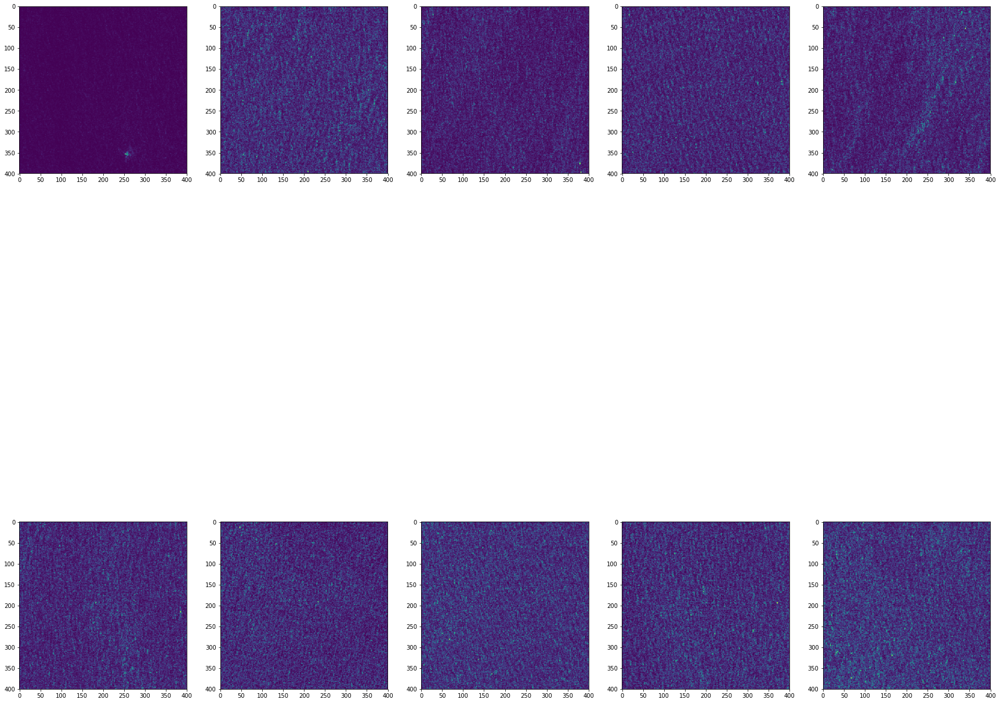

In [64]:
plt.figure(figsize=(30, 30))
for i in range(10):
    plt.subplot(2, 5,i+1)
    plt.imshow(dataset[255+i])

In [37]:
streak = [1, 2, 15, 16,17,35,38,39,40,49,58,60,68,74,74,116,117,127,128,129,130,140,141,143,151,161,163,171,172,189,238,247,248,250,254,258,262]

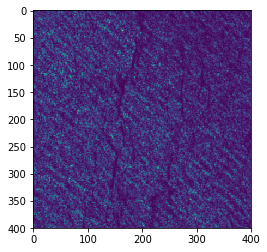

In [38]:
plt.imshow(dataset[115])

In [39]:
f = os.listdir('/Volumes/Yangchao/subset_netcdf/')

In [40]:
dataset = np.array(dataset)

In [41]:
f = np.array(f)

In [42]:
f1 = f[streak]

In [43]:
data1 = dataset[streak]

In [97]:
index = 6

In [135]:
f1[index]

'Ascending_41010_subset_127_ 5.0_4.0_S1A_IW_GRDH_1SDV_20170719T232015_20170719T232040_017547_01D590_DF13'

In [99]:
dir_ = direction.FFT2(data1[index])
dir_1 = direction.main_lg(data1[index], mode='sobel', downsize=(200, 200))
dir_2 = direction.main_lg(data1[index], mode='igl', downsize=(200, 200))

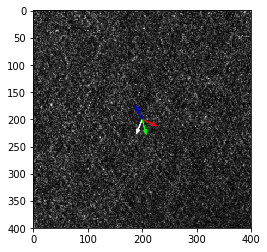

In [136]:
plt.imshow(data1[index],'gray')
plt.arrow(200, 200,  20*np.cos((dir_-90)%180/180*np.pi),20*np.sin((dir_-90)%180/180*np.pi), color=(1, 1, 1), head_width=6.0)
plt.arrow(200, 200, 20*np.cos((dir_1[3]-90)%180/180*np.pi), 20*np.sin((dir_1[3]-90)%180/180*np.pi), color=(1, 0, 0), head_width=6.0)
plt.arrow(200, 200, 20*np.cos((dir_2[3]-90)%180/180*np.pi), 20*np.sin((dir_2[3]-90)%180/180*np.pi), color=(0, 1, 0), head_width=6.0)
plt.arrow(200, 200, 20*np.cos(ndbc_dir[index]/180*np.pi), 20*np.sin(ndbc_dir[index]/180*np.pi), color=(0, 0, 1), head_width=6.0)

In [79]:
dir_ = direction.FFT2(data1[index])
dir_1 = direction.main_lg(data1[index], mode='sobel', downsize=(200, 200))
dir_2 = direction.main_lg(data1[index], mode='igl', downsize=(200, 200))

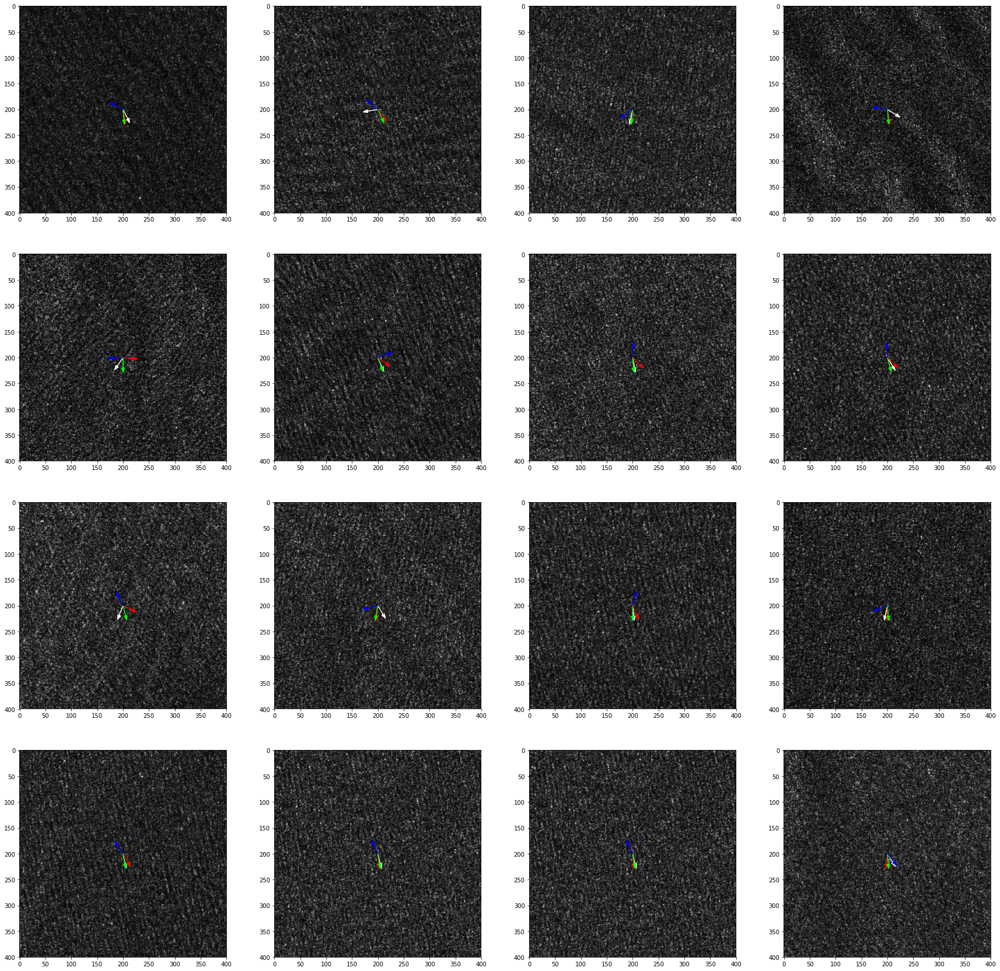

In [138]:
plt.figure(figsize=(30, 30))
for index in range(16):
    plt.subplot(4, 4, index+1)
    dir_ = direction.FFT2(data1[index])
    dir_1 = direction.main_lg(data1[index], mode='sobel', downsize=(200, 200))
    dir_2 = direction.main_lg(data1[index], mode='igl', downsize=(200, 200))
    plt.imshow(data1[index],'gray')
    plt.arrow(200, 200,  20*np.cos((dir_-90)%180/180*np.pi),20*np.sin((dir_-90)%180/180*np.pi), color=(1, 1, 1), head_width=6.0)
    plt.arrow(200, 200, 20*np.cos((dir_1[3]-90)%180/180*np.pi), 20*np.sin((dir_1[3]-90)%180/180*np.pi), color=(1, 0, 0), head_width=6.0)
    plt.arrow(200, 200, 20*np.cos((dir_2[3]-90)%180/180*np.pi), 20*np.sin((dir_2[3]-90)%180/180*np.pi), color=(0, 1, 0), head_width=6.0)
    plt.arrow(200, 200, 20*np.cos(ndbc_dir[index]/180*np.pi), 20*np.sin(ndbc_dir[index]/180*np.pi), color=(0, 0, 1), head_width=6.0)

In [44]:
ndbc = []
ascending = []
for string in f1:
    ndbc.append(int(string.split('_')[3]))
    ascending.append(string.split('_')[0])

In [45]:
ascending = np.array(ascending)

In [46]:
ascending[ascending=='Ascending']=280
ascending[ascending=='Descending']=190

In [47]:
ascending

array(['190', '190', '280', '280', '280', '190', '280', '280', '280',
       '280', '280', '280', '280', '280', '280', '280', '280', '280',
       '280', '280', '280', '280', '280', '280', '280', '280', '280',
       '280', '280', '280', '280', '190', '190', '190', '190', '190',
       '190'], dtype='<U10')

In [48]:
ascending = ascending.astype('int32')

In [49]:
ndbc_dir = ascending-ndbc+90

In [50]:
dd = pd.DataFrame({'file_name':f1, 'ndbc_dir':ndbc_dir})

In [52]:
dd.to_csv('file.csv', index=False)

In [7]:
path = '/Volumes/Yangchao/Sentient/'
product = ProductIO.readProduct(path+'S1B_IW_GRDH_1SDV_20170522T161401_20170522T161430_005713_00A024_4EF8.zip')

In [142]:
ProductIO.writeProduct(product, 'S1A_IW_GRDH_1SDV_20170719T232015_20170719T232040_017547_01D590_DF13.nc', 'NetCDF4-CF')

RuntimeError: java.lang.OutOfMemoryError: Java heap space

In [8]:
produc1 = calibrate.thermal_app(product)
product2 = calibrate.calibrate(produc1)
product3 = calibrate.specklefilter(product2, filter='Median')
#ProductIO.writeProduct(product3, 'S1B_IW_GRDH_1SDV_20170522T161401_20170522T161430_005713_00A024_4EF8.nc', 'NetCDF4-CF')

----thermal remove----
----apply orbit file----
-----calibrate----
----speckle remove----


In [4]:
product2 = calibrate.calibrate(produc1)

-----calibrate----


In [5]:
product3 = calibrate.specklefilter(product2, filter='Median')

----speckle remove----


In [11]:
ProductIO.writeProduct(product3, 'S1B_IW_GRDH_1SDV_20170522T161401_20170522T161430_005713_00A024_4EF8.nc', 'NetCDF4-CF')

In [4]:
d = Dataset('./S1A_IW_GRDH_1SDV_20170719T232015_20170719T232040_017547_01D590_DF13.nc')

In [6]:
d.variables.keys()

odict_keys(['Sigma0_VH', 'Sigma0_VV', 'latitude', 'longitude', 'incident_angle', 'elevation_angle', 'slant_range_time', 'lat', 'lon'])

In [7]:
sigma_vv = d.variables['Sigma0_VV'][:]

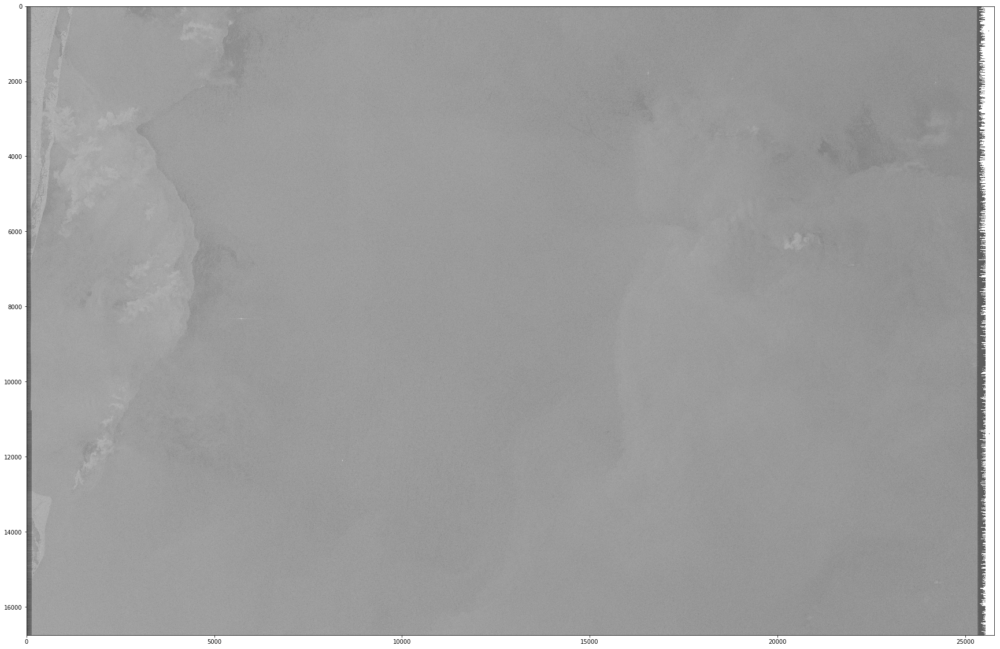

In [12]:
plt.figure(figsize=(30,30))
plt.imshow(10*np.log10(sigma_vv), 'gray')

In [10]:
sigma_vv[0][0]

2.0460686e-05

In [3]:
path = '/Volumes/Yangchao/'
n = pd.read_csv(path+'data/ndbc_station_information.csv')

In [4]:
n.head(5)

,name,height,lat,lon
0,0y2w3,10.0,44.794,-87.313
1,13001,4.0,12.000,-23.000
2,13002,4.0,21.000,-23.000
3,13008,4.0,15.000,-38.000
4,13009,4.0,8.000,-38.000


In [5]:
n[n.name=='51000']

,name,height,lat,lon
716,51000,5.0,23.538,-153.808


In [2]:
dd = ProductIO.readProduct('./S1A_IW_GRDH_1SDV_20170719T232015_20170719T232040_017547_01D590_DF13.nc')

In [9]:
target = calibrate.subset(product3, GeoRegion=True, w='POLYGON((-154.058 23.288,-153.558 23.288, -153.558 23.788,-154.058 23.788,-154.058 23.288))')

----subset----


In [5]:
target = calibrate.subset(dd, GeoRegion=True, w='POLYGON((-78.7 28.634,-78.2 28.634, -78.2 29.134, -78.7 29.134, -78.7 28.634))')

----subset----


In [10]:
ProductIO.writeProduct(target, 'subset_S1B_IW_GRDH_1SDV_20170522T161401_20170522T161430_005713_00A024_4EF8.nc', 'NetCDF4-CF')

In [13]:
name = dd.getTiePointGridAt('longitude')

RuntimeError: no matching Java method overloads found

In [24]:
d = Dataset('./subset_S1B_IW_GRDH_1SDV_20170522T161401_20170522T161430_005713_00A024_4EF8.nc')

In [25]:
si = d.variables['Sigma0_VV'][:]

In [26]:
d.variables.keys()

odict_keys(['Sigma0_VH', 'Sigma0_VV', 'latitude', 'longitude', 'incident_angle', 'elevation_angle', 'slant_range_time', 'lat', 'lon'])

In [27]:
lat = d.variables['latitude'][:]
lon = d.variables['longitude'][:]

In [27]:
lon

masked_array(
  data=[[-153.59783935546875, -153.59793090820312, -153.5980224609375,
         ..., -154.0412139892578, -154.0413055419922,
         -154.04141235351562],
        [-153.5978546142578, -153.5979461669922, -153.59803771972656,
         ..., -154.04122924804688, -154.0413360595703,
         -154.0414276123047],
        [-153.59786987304688, -153.59796142578125, -153.5980682373047,
         ..., -154.041259765625, -154.04135131835938,
         -154.04144287109375],
        ...,
        [-153.7173309326172, -153.71743774414062, -153.717529296875, ...,
         -154.1588134765625, -154.15892028808594, -154.1590118408203],
        [-153.7173614501953, -153.7174530029297, -153.71754455566406,
         ..., -154.15884399414062, -154.158935546875,
         -154.15902709960938],
        [-153.71737670898438, -153.71746826171875, -153.7175750732422,
         ..., -154.1588592529297, -154.15895080566406,
         -154.1590576171875]],
  mask=[[False, False, False, ..., False, False, 

In [28]:
si.shape[0]

6236

In [29]:
dir_ = np.zeros((6200, 4600))
dir_1 = np.zeros((6200, 4600))
dir_2 = np.zeros((6200, 4600))
for i in np.arange(200, 6200,400):
    for j in np.arange(200, 4600, 400):
        img = si[i-200:i+200, j-200:j+200]
        dir_[i,j] = (direction.FFT2(img)-90)%180
        dir_1[i,j] = (direction.main_lg(img, mode='sobel', downsize=(200, 200))[-1]-90)%180
        dir_2[i,j] = (direction.main_lg(img, mode='igl', downsize=(200, 200))[-1]-90)%180
        if np.abs(dir_[i,j]-ndbc_dir[0])>(dir_[i,j]-ndbc_dir[0]+180):
            dir_[i,j] = (dir_[i,j]+180)%360
        if np.abs(dir_1[i,j]-ndbc_dir[0])>np.abs(dir_1[i,j]-ndbc_dir[0]+180):
            dir_1[i,j] = (dir_1[i,j]+180)%360
        if np.abs(dir_2[i,j]-ndbc_dir[0])>np.abs(dir_2[i,j]-ndbc_dir[0]+180):
            dir_2[i,j] = (dir_2[i,j]+180)%360

NameError: name 'ndbc_dir' is not defined

/Users/yangchao/anaconda/lib/python3.5/site-packages/ipykernel/__main__.py:23: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/Users/yangchao/anaconda/lib/python3.5/site-packages/ipykernel/__main__.py:24: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/Users/yangchao/anaconda/lib/python3.5/site-packages/ipykernel/__main__.py:25: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which w

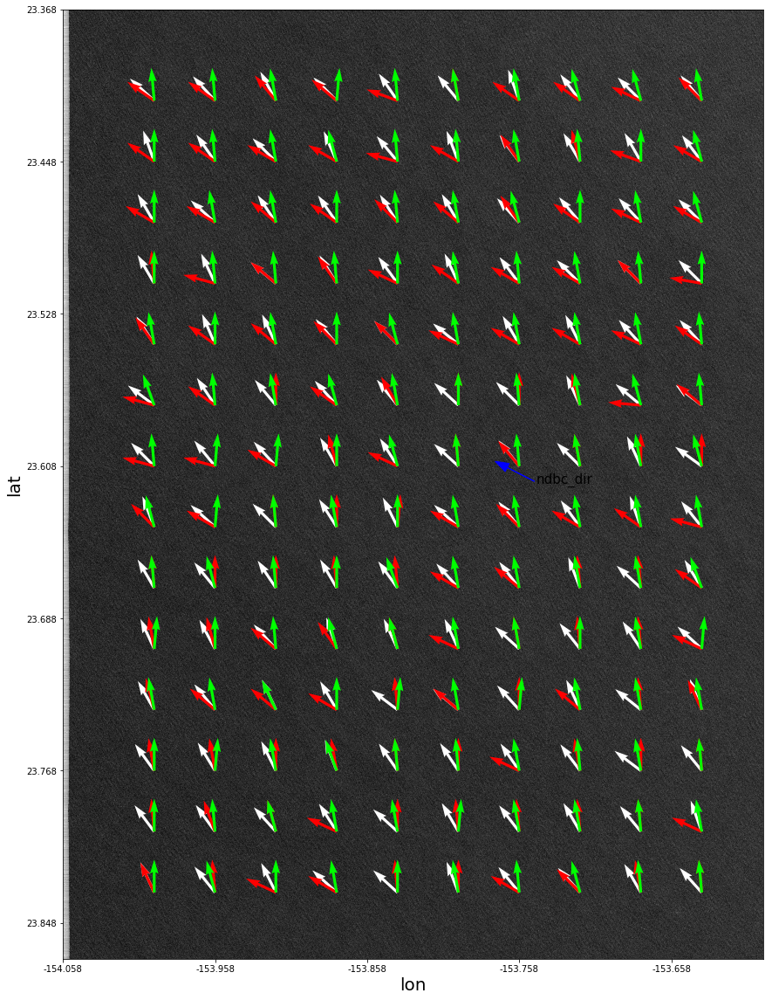

In [117]:

#image is a grid,  horiz is x, vert is y, and y positive is down
#X and Y point to points in grid
X,Y = np.meshgrid(np.arange(4600),np.arange(6400))
#x, y is position that points to the point you want to plot wind
x, y = np.arange(600, 6200, 400), np.arange(600, 4400, 400)
points = np.meshgrid(x, y)
plt.figure(figsize=(20,20))
#wind speed is show as image with color 'jet', 0 is blue, max is red
plt.imshow(-10*np.log10(si), 'gray')
ax = plt.gca()
ax.set_xticklabels(np.round(1000*np.arange(-154.158,-153.498,0.1))/1000)
ax.set_yticklabels(np.round(1000*np.arange(23.288, 23.888,0.08))/1000)
plt.ylabel('lat',fontsize=20)
plt.xlabel('lon',fontsize=20)
U1 = 20*np.cos(dir_/180*np.pi)
V1 = 20*np.sin(dir_/180*np.pi)
U2 = 20*np.cos(dir_1/180*np.pi)
V2 = 20*np.sin(dir_1/180*np.pi)
U3 = 20*np.cos(dir_2/180*np.pi)
V3 = 20*np.sin(dir_2/180*np.pi)
#plot quiver in the points you want to plot wind, U and V is horiz component and vertic component respectively, width is the width of arrow
plt.quiver(X[points], Y[points], U1[points], -V1[points], width=0.004, color=(1,1,1))
plt.quiver(X[points], Y[points], U2[points], -V2[points], width=0.004,color=(1,0,0))
plt.quiver(X[points], Y[points], U3[points], -V3[points], width=0.004,color=(0,1,0))
plt.arrow(3100, 3100, 200*np.cos(ndbc_dir[0]/180*np.pi), 200*np.sin(ndbc_dir[0]/180*np.pi), color=(0, 0, 1),width=0.04,head_width=60)
plt.text(3110,3110,'ndbc_dir', fontsize=15)
plt.savefig('./wind.eps')

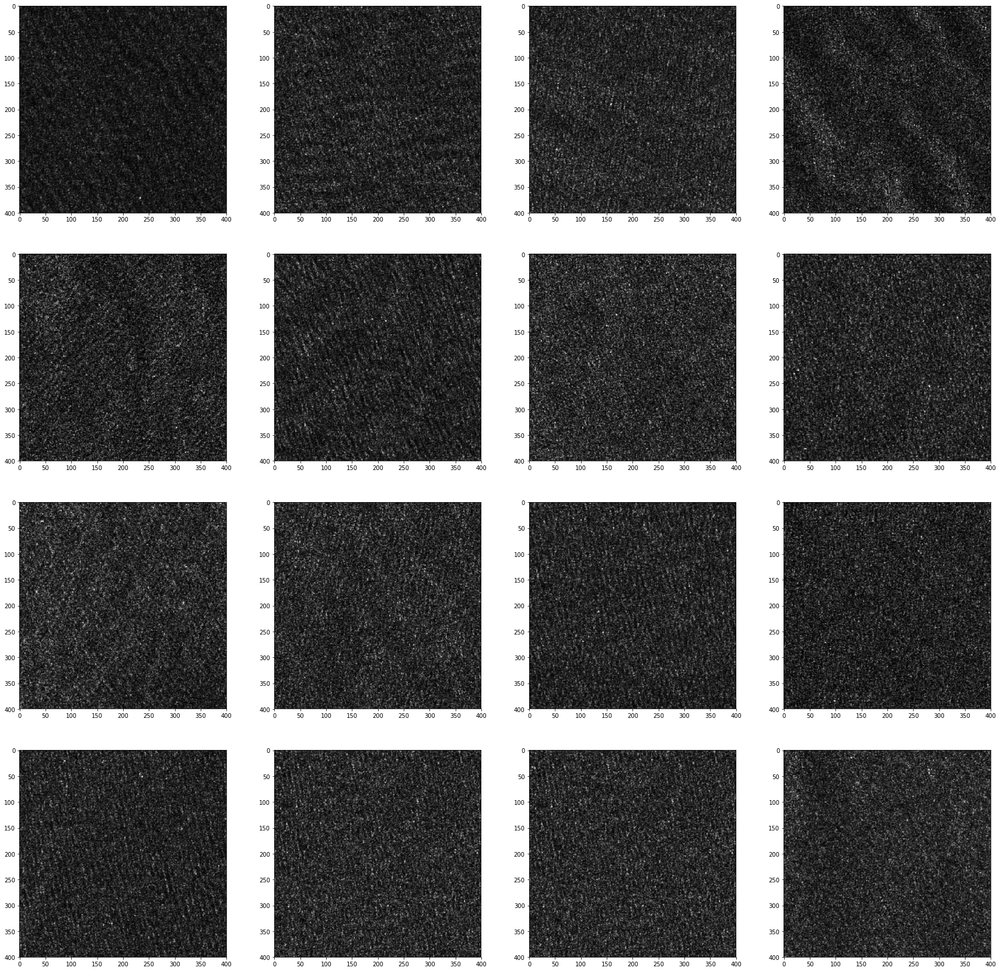

In [25]:
plt.figure(figsize=(30, 30))
for i in range(16):
    plt.subplot(4, 4 , i+1)
    plt.imshow(data1[i], 'gray')

In [76]:
dir_[200, 200]

90.0

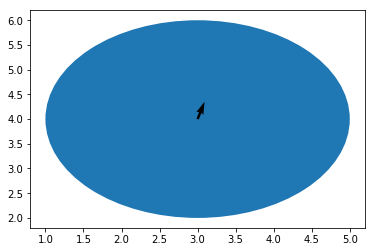

In [25]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Circle
from matplotlib.collections import PatchCollection
x=np.random.rand(5, 5)
fig, az = plt.subplots()
patch = []
patch.append(Circle((3, 4), 2))
collec = PatchCollection(patch)
az.add_collection(collec)
az.quiver(3, 4, 2, 5)
plt.show()

In [ ]:
def PlotWind(speed, U, V):
    #image is a grid,  horiz is x, vert is y, and y positive is down
    #X and Y point to points in grid
    X,Y = np.meshgrid(np.arange(161),np.arange(161))
    #x, y is position that points to the point you want to plot wind
    x, y = np.arange(2, 161, 4), np.arange(2, 161, 4)
    points = np.meshgrid(x, y)
    plt.figure(figsize=(20,20))
    #wind speed is show as image with color 'jet', 0 is blue, max is red
    plt.imshow(speed, 'jet')
    ax = plt.gca()
    ax.set_xticklabels(np.linspace(130,150, 11,endpoint=True))
    a = np.linspace(25, 45, 11, endpoint=True)
    ax.set_yticklabels(a[::-1])
    plt.ylabel('lat',fontsize=20)
    plt.xlabel('lon',fontsize=20)
    plt.colorbar()
    #plot quiver in the points you want to plot wind, U and V is horiz component and vertic component respectively, width is the width of arrow
    plt.quiver(X[points], Y[points], U[points], V[points], width=0.004)

In [57]:
X.shape

(4600, 6400)

In [59]:
x.shape

(11,)

In [61]:
points[0].shape

(16, 11)

In [66]:
points

[array([[ 200,  600, 1000, 1400, 1800, 2200, 2600, 3000, 3400, 3800, 4200],
        [ 200,  600, 1000, 1400, 1800, 2200, 2600, 3000, 3400, 3800, 4200],
        [ 200,  600, 1000, 1400, 1800, 2200, 2600, 3000, 3400, 3800, 4200],
        [ 200,  600, 1000, 1400, 1800, 2200, 2600, 3000, 3400, 3800, 4200],
        [ 200,  600, 1000, 1400, 1800, 2200, 2600, 3000, 3400, 3800, 4200],
        [ 200,  600, 1000, 1400, 1800, 2200, 2600, 3000, 3400, 3800, 4200],
        [ 200,  600, 1000, 1400, 1800, 2200, 2600, 3000, 3400, 3800, 4200],
        [ 200,  600, 1000, 1400, 1800, 2200, 2600, 3000, 3400, 3800, 4200],
        [ 200,  600, 1000, 1400, 1800, 2200, 2600, 3000, 3400, 3800, 4200],
        [ 200,  600, 1000, 1400, 1800, 2200, 2600, 3000, 3400, 3800, 4200],
        [ 200,  600, 1000, 1400, 1800, 2200, 2600, 3000, 3400, 3800, 4200],
        [ 200,  600, 1000, 1400, 1800, 2200, 2600, 3000, 3400, 3800, 4200],
        [ 200,  600, 1000, 1400, 1800, 2200, 2600, 3000, 3400, 3800, 4200],
        [ 20

In [71]:
U1[points]

/Users/yangchao/anaconda/lib/python3.5/site-packages/ipykernel/__main__.py:1: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  if __name__ == '__main__':


IndexError: index 6200 is out of bounds for axis 0 with size 6200

In [70]:
U1.shape

(6200, 4600)

In [86]:
f1[0]

'Descending_51000_subset_ 73_ 7.2_5.0_S1B_IW_GRDH_1SDV_20170522T161401_20170522T161430_005713_00A024_4EF8'

In [103]:
dir_1[200+400*14,200+400*3]

25.0

In [106]:
(dir_1[200+400*14,200+400*3]-ndbc_dir[0])%360>(dir_1[200+400*14,200+400*3]-ndbc_dir[0]-180)%360

False

In [107]:
ndbc_dir[0]

207

In [108]:
(dir_1[200+400*14,200+400*3]-ndbc_dir[0])%360

178.0

In [109]:
(dir_1[200+400*14,200+400*3]-ndbc_dir[0]-180)%360

358.0

In [118]:
f9 = Dataset('/Users/yangchao/Desktop/lionrock/cal/S1A_EW_GRDM_1SDV_20160829T203410_20160829T203514_012820_01437E_0F09_Noise-Cor_Orb_Cal_Spk_msk.nc')

In [119]:
sigma = f9.variables['Sigma0_VV'][:]

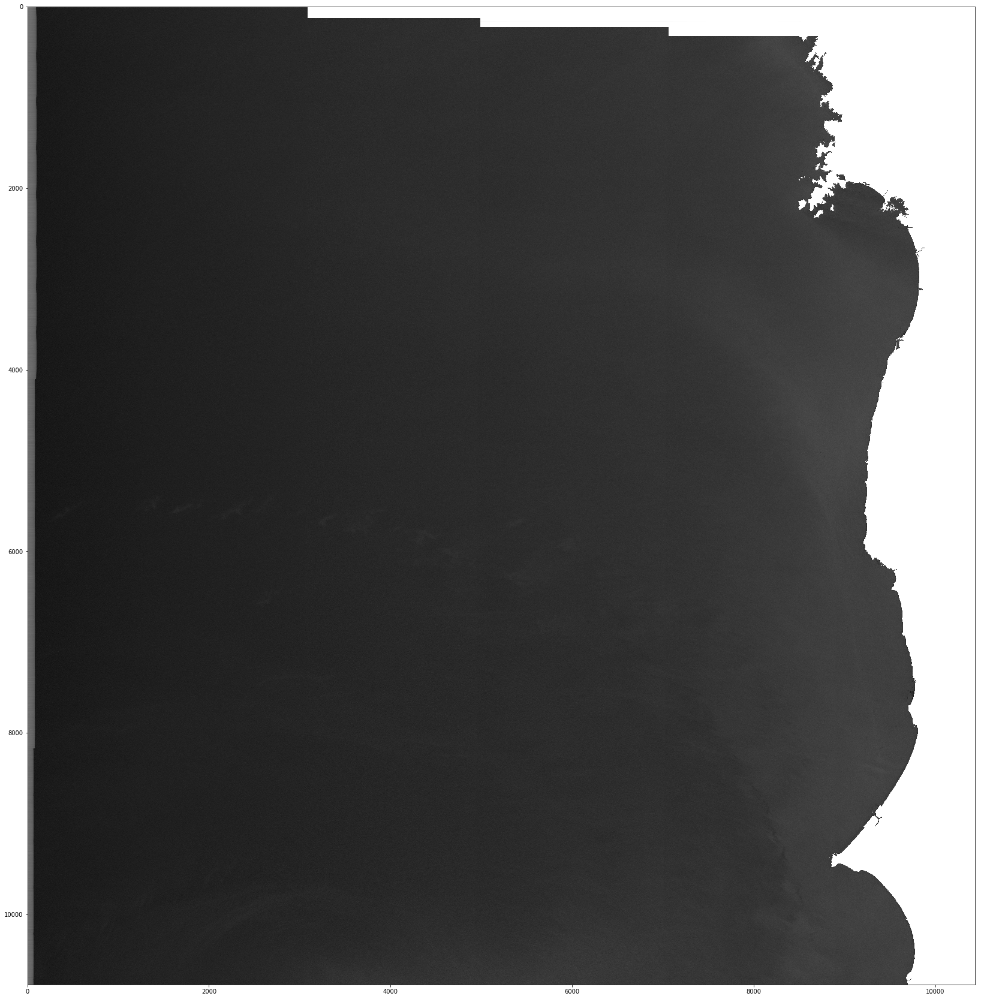

In [125]:
plt.figure(figsize=(30, 30))
plt.imshow(-10*np.log10(sigma),'gray')

In [126]:
pp = sigma[4000:, 500:8000]

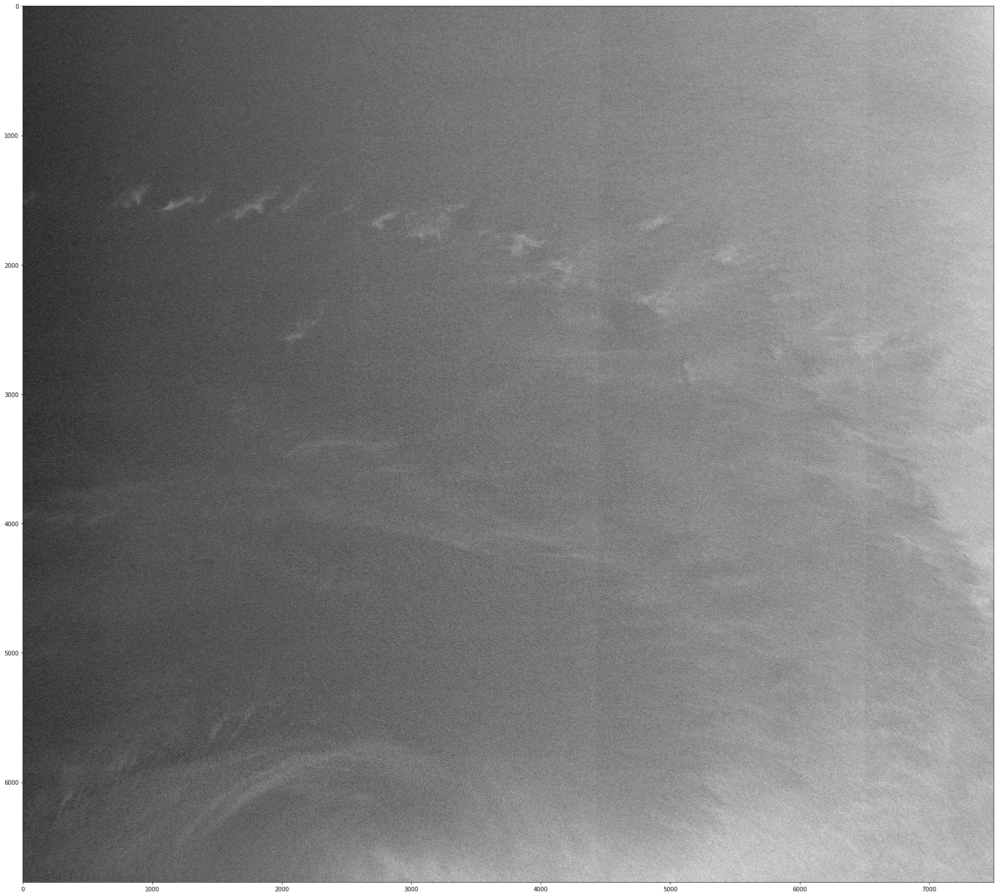

In [142]:
plt.figure(figsize=(30, 30))
plt.imshow(-10*np.log10(pp),'gray')

In [33]:
def get_dir(figure,sub_size):
    sub_size_h = int(sub_size/2)
    shape_x = figure.shape[0]
    shape_y = figure.shape[1]
    dir_ = np.zeros((shape_x, shape_y))
    dir_1 = np.zeros((shape_x, shape_y))
    dir_2 = np.zeros((shape_x, shape_y))
    #cut off head and tail
    for i in np.arange(sub_size_h, shape_x-sub_size_h,sub_size):
        for j in np.arange(sub_size_h, shape_y-sub_size_h, sub_size):
            img = figure[i-sub_size_h:i+sub_size_h, j-sub_size_h:j+sub_size_h]
            dir_[i,j] = (direction.FFT2(img)-90)%180
            dir_1[i,j] = (direction.main_lg(img, mode='sobel', downsize=(sub_size_h, sub_size_h))[-1]-90)%180
            dir_2[i,j] = (direction.main_lg(img, mode='igl')[-1]-90)%180
#             if np.abs(dir_[i,j]-ndbc_)>(dir_[i,j]-ndbc_+180):
#                 dir_[i,j] = (dir_[i,j]+180)%360
#             if np.abs(dir_1[i,j]-ndbc_)>np.abs(dir_1[i,j]-ndbc_+180):
#                 dir_1[i,j] = (dir_1[i,j]+180)%360
#             if np.abs(dir_2[i,j]-ndbc_)>np.abs(dir_2[i,j]-ndbc_+180):
#                 dir_2[i,j] = (dir_2[i,j]+180)%360
    return dir_, dir_1, dir_2
def plot_dir(dire, figure,sub_size,file_name):
    sub_size_h = int(sub_size/2)
    shape_x = figure.shape[0]
    shape_y = figure.shape[1]
    #image is a grid,  horiz is x, vert is y, and y positive is down
    #X and Y point to points in grid
    X,Y = np.meshgrid(np.arange(shape_y),np.arange(shape_x))
    #x, y is position that points to the point you want to plot wind
    x, y = np.arange(int(sub_size*1.5), shape_x-sub_size_h, sub_size), np.arange(int(sub_size*1.5), shape_y-sub_size_h, sub_size)
    points = np.meshgrid(x, y)
    plt.figure(figsize=(20,20))
    #wind speed is show as image with color 'jet', 0 is blue, max is red
    plt.imshow(-10*np.log10(figure), 'gray')
#     ax = plt.gca()
#     ax.set_xticklabels(np.round(1000*np.arange(-154.158,-153.498,0.1))/1000)
#     ax.set_yticklabels(np.round(1000*np.arange(23.288, 23.888,0.08))/1000)
#     plt.ylabel('lat',fontsize=20)
#     plt.xlabel('lon',fontsize=20)
    index = 0
    color_list = [(1, 1, 1), (1, 0, 0), (0, 1, 0), (0, 0, 1), (1, 1, 0), (1, 0, 1), (0, 1, 1)]
    for d in dire:
        U1 = 20*np.cos(d/180*np.pi)
        V1 = 20*np.sin(d/180*np.pi)
        #plot quiver in the points you want to plot wind, U and V is horiz component and vertic component respectively, width is the width of arrow
        plt.quiver(X[points], Y[points], U1[points], -V1[points], width=0.004, color=color_list[index])
        index+=1
    #plot quiver in the points you want to plot wind, U and V is horiz component and vertic component respectively, width is the width of arrow
#     plt.arrow(max(shape_x, shape_y)/2, max(shape_x, shape_y)/2, 200*np.cos(ndbc_/180*np.pi), 200*np.sin(ndbc_/180*np.pi), color=(0, 0, 1),width=0.04,head_width=60)
#     plt.text(max(shape_x, shape_y)/2+10,max(shape_x, shape_y)/2+10,'ndbc_dir', fontsize=15)
    plt.savefig(file_name)

In [53]:
direc = direction.get_dir(si, 200, remove_ambi = True, ndbc_=dd.ndbc_dir[0])

/Users/yangchao/anaconda/lib/python3.5/site-packages/ipykernel/__main__.py:46: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.


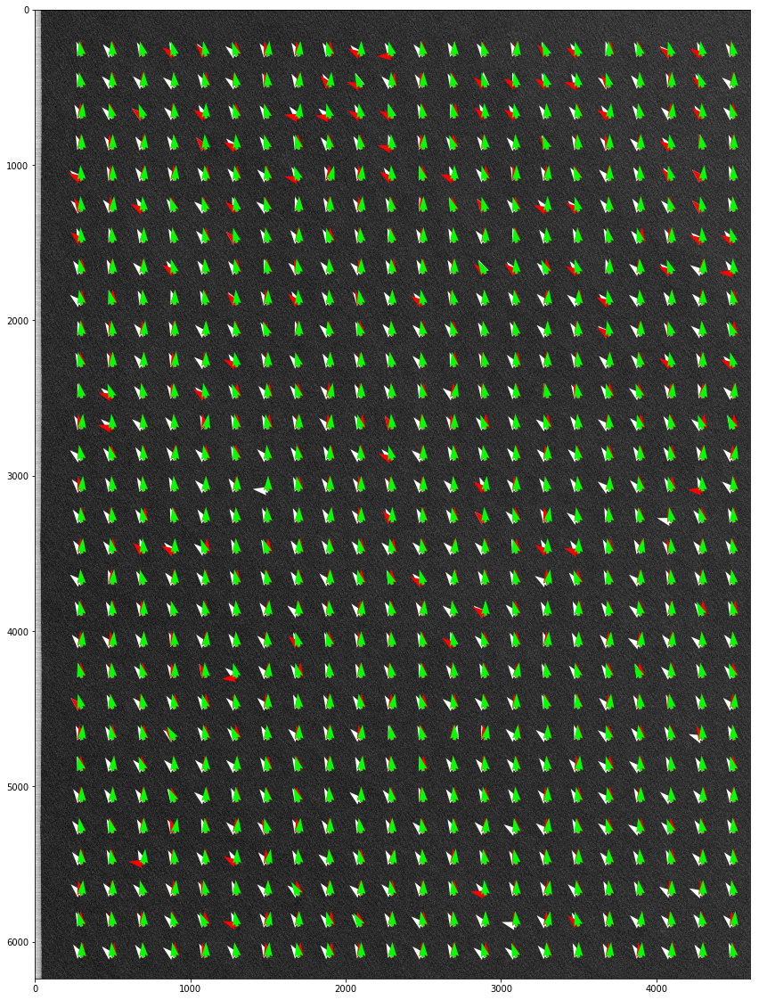

In [54]:
plot_dir(direc, si, 200, './wind.eps')

/Users/yangchao/anaconda/lib/python3.5/site-packages/direction.py:180: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  plt.quiver(X[points], Y[points], U1[points], -V1[points], width=0.004, color=(1,1,1))
/Users/yangchao/anaconda/lib/python3.5/site-packages/direction.py:181: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  plt.quiver(X[points], Y[points], U2[points], -V2[points], width=0.004,color=(1,0,0))
/Users/yangchao/anaconda/lib/python3.5/site-packages/direction.py:182: FutureWarning: Using a non-tuple sequence for multidimensional index

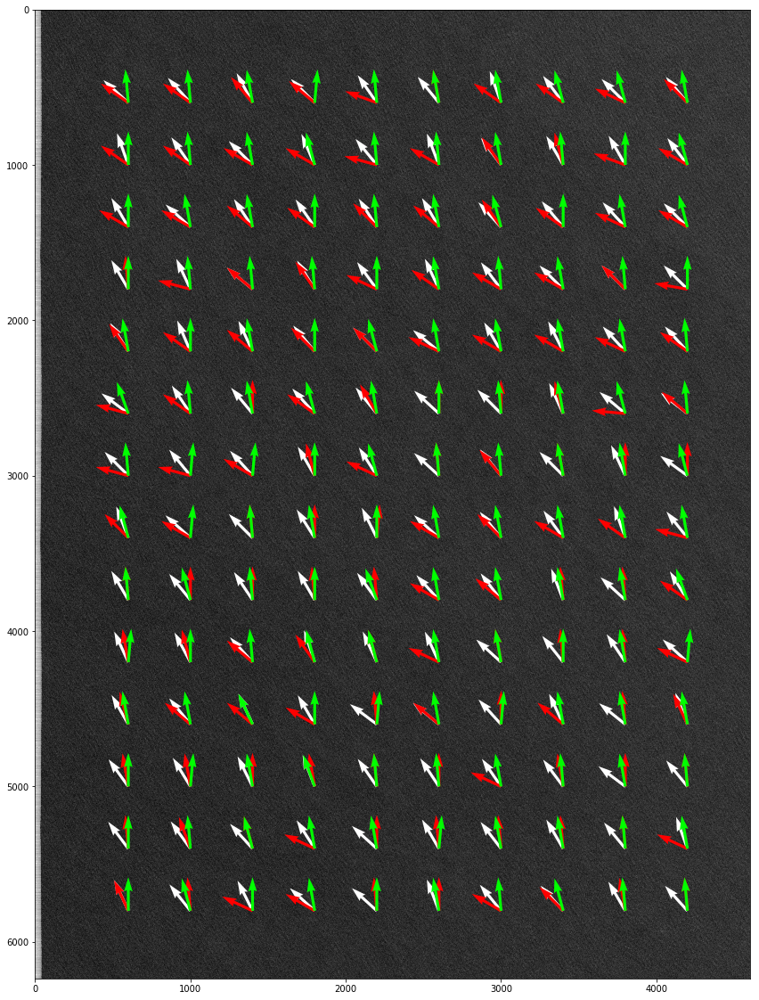

In [22]:
direc = direction.get_dir(si, 400, remove_ambi = True, ndbc_ = ndbc_dir[0] )
direction.plot_dir(direc, si, 400, './wind2.eps')

In [164]:
si.shape

(6236, 4604)

In [20]:
x= [1, 2, 3]

In [16]:
x = np.reshape(x, (1,2,3))

In [18]:
x = np.concatenate((y, 2*y), 0)

array([[[1, 2, 3],
        [1, 2, 3]],

       [[1, 2, 3],
        [1, 2, 3]]])

In [21]:
#median filter based on background filed b select the best result between w1 and w2, which have the same shape
#w1 is the initila wind filed
#w3 is the final wind filed
def Median_filter(w1, w2, b, filter_size):
    shape_x = w1.shape[0]
    shape_y = w1.shape[1]
    w3 = np.copy(w1)
    filter_size_h = int(filter_size/2)
    for i in np.arange(filter_size_h, shape_x-filter_size_h, filter_size):
        for j in np.arange(filter_size_h, shape_y-filter_size_h, filter_size):
            imag = w1[ i-filter_size_h:i+filter_size_h, j-filter_size_h:j+filter_size_h]
            imag1 = w2[ i-filter_size_h:i+filter_size_h, j-filter_size_h:j+filter_size_h]
            m = np.median(imag)
            for k in range(filter_size):
                for t in range(filter_size):
                    if np.abs(imag1[k, t]-m)<np.abs(imag[k, t]-m):
                        w3[i-filter_size_h+k, j-filter_size_h+t]= imag1[k, t]
        if shape_y%filter_size==0:
            continue
        imag = w1[i-filter_size_h:i+filter_size_h, shape_y%filter_size:]
        imag1 = w2[ i-filter_size_h:i+filter_size_h, shape_y%filter_size:]
        m = np.median(imag)
        for k in range(filter_size):
                for t in range(shape_y%filter_size):
                    if np.abs(imag1[k, t]-m)<np.abs(imag[k, t]-m):
                        w3[i-filter_size_h+k, j+filter_size_h+t]= imag1[k, t]
    if shape_x%filter_size!=0:
        for e in np.arange(filter_size_h, shape_y-filter_size_h, filter_size):
            imag = w1[shape_x%filter_size:, e-filter_size_h:j+filter_size_h]
            imag1 = w2[shape_x%filter_size:, e-filter_size_h:j+filter_size_h]
            m = np.median(imag)
            for k in range(shape_x%filter_size):
                for t in range(filter_size):
                    if np.abs(imag1[k, t]-m)<np.abs(imag[k, t]-m):
                        w3[i+filter_size_h+k, e-filter_size_h+t]= imag1[k, t]
        if shape_y%filter_size!=0:
            imag = w1[shape_x%filter_size:, shape_y%filter_size:]
            imag1 = w2[ shape_x%filter_size:, shape_y%filter_size:]
            m = np.median(imag)
            for k in range(shape_y%filter_size):
                    for t in range(shape_y%filter_size):
                        if np.abs(imag1[k, t]-m)<np.abs(imag[k, t]-m):
                            w3[i+filter_size_h+k, j+filter_size_h+t]= imag1[k, t]
    return w3

In [56]:
dir_ = direc[0]
dir_1 = direc[1]

In [58]:
dir_3 = Median_filter(dir_, dir_1, dd.ndbc_dir[0], 8)

/Users/yangchao/anaconda/lib/python3.5/site-packages/ipykernel/__main__.py:46: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.


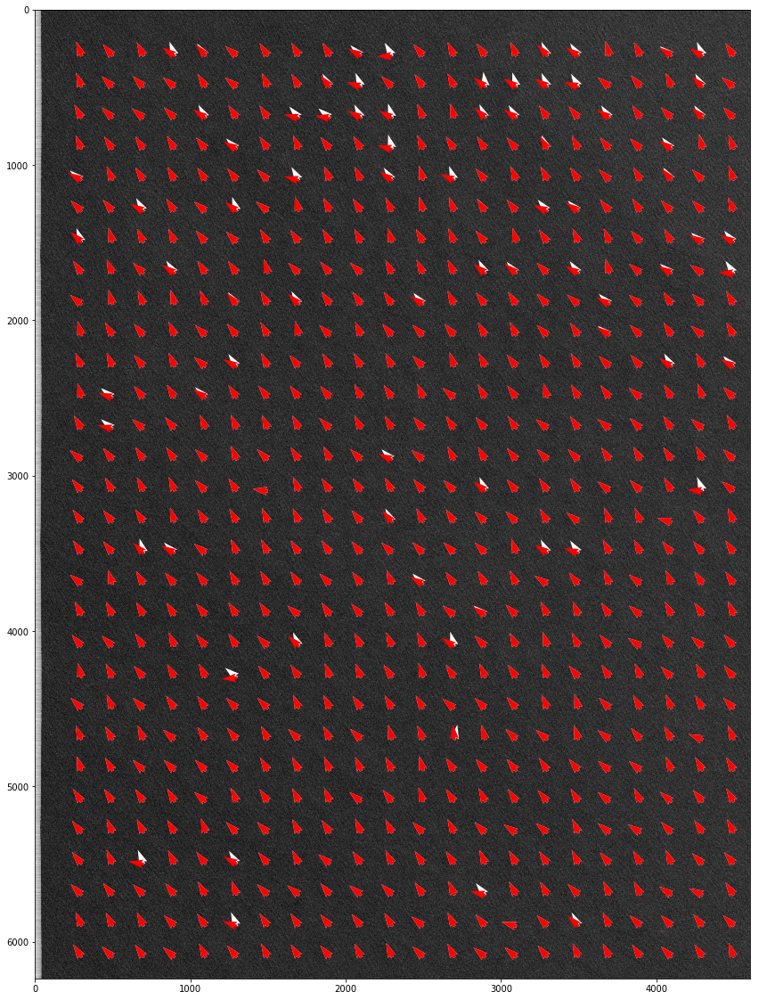

In [59]:
plot_dir((dir_, dir_3), si, 200, 'median.eps')

In [60]:
file_1 = os.listdir('/Volumes/Yangchao/subset_cal/')

In [61]:
ascding = []
ndbc = []
ndbc_speed = []
ndbc_dir = []
ndbc_height = []
sar_file_name = []
for f in file_1:
    f_list = f.split('_')
    ascding.append(f_list[0])
    ndbc.append(f_list[1])
    ndbc_dir.append(int(f_list[3]))
    ndbc_speed.append(float(f_list[4]))
    ndbc_height.append(float(f_list[5]))
    sar_file_name.append('_'.join(f_list[6:])[:-4])

In [62]:
sar_file_name[0]

'S1B_IW_GRDH_1SDV_20170522T142850_20170522T142915_005712_00A01B_C4AD'

In [63]:
sar_ndbc = pd.DataFrame({'ascending':ascding, 'ndbc':ndbc, 'ndbc_speed':ndbc_speed, 'ndbc_dir':ndbc_dir, 'ndbc_height':ndbc_height, 'sar_name':sar_file_name})

In [64]:
sar_ndbc.to_csv('./sar_ndbc.csv')

In [2]:
path = '/Volumes/Yangchao/Sentient/'

In [3]:
data = ProductIO.readProduct(path + 'S1A_IW_GRDH_1SDV_20170520T140035_20170520T140100_016666_01BA9A_0D7A.zip')

In [4]:
product1 = calibrate.thermal_app(data)

----thermal remove----
----apply orbit file----


In [5]:
product2 = calibrate.calibrate(product1)

-----calibrate----


In [6]:
product3 = calibrate.specklefilter(product2, filter='Median')

----speckle remove----


In [7]:
product4 = calibrate.mask(product3)

----mask----


In [8]:
ProductIO.writeProduct(product4, './S1A_IW_GRDH_1SDV_20170520T140035_20170520T140100_016666_01BA9A_0D7A.nc', 'NetCDF4-CF')

In [10]:
data = Dataset('./S1A_IW_GRDH_1SDV_20170518T233538_20170518T233603_016643_01B9E6_D58F.nc')
sigma_vv = data.variables['Sigma0_VV'][:]

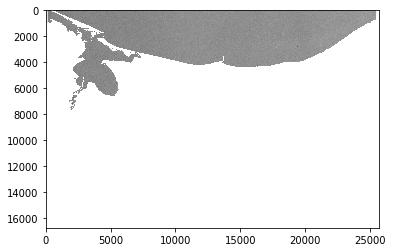

In [11]:
plt.imshow(-10*np.log10(sigma_vv), 'gray')

In [12]:
sub = sigma_vv[:4000, 5000:20000]

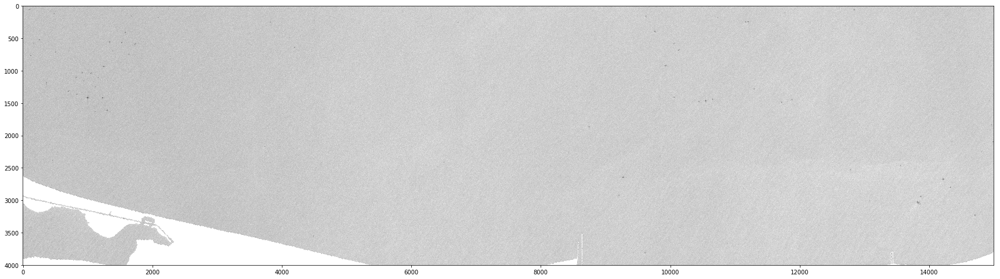

In [13]:
plt.figure(figsize=(30, 30))
plt.imshow(-10*np.log10(sub), 'gray')

In [17]:
ndbc_dire = (350-129+90)%360

In [20]:
dire_ = direction.get_dir(sub, sub_size=400, remove_ambi = True, ndbc_= ndbc_dire)

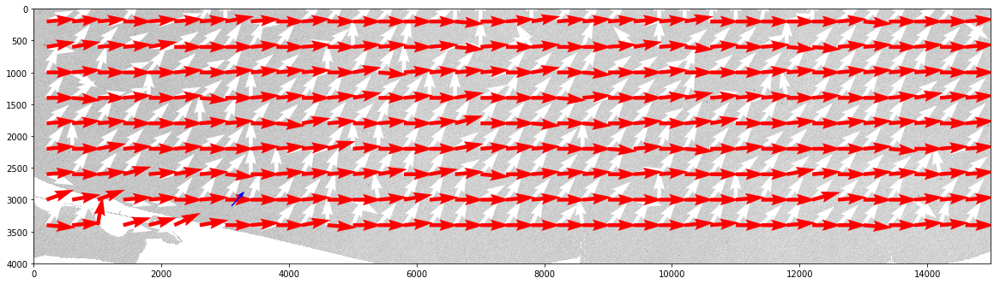

In [21]:
direction.plot_dir(dire_, sub, sub_size=400, file_name='./newwind_5ccb.eps')
plt.arrow(3100, 3100, 200*np.cos(ndbc_dire/180*np.pi), 200*np.sin(ndbc_dire/180*np.pi), color=(0, 0, 1),width=0.04,head_width=60)

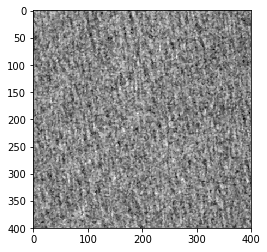

In [8]:
plt.imshow(10*np.log10(sub[1000:1400, 1000:1400]),'gray')

In [9]:
np.max(dire_[1])

275.0

In [9]:
data = Dataset('./S1A_IW_GRDH_1SDV_20170520T140035_20170520T140100_016666_01BA9A_0D7A.nc')
sigma_vv = data.variables['Sigma0_VV'][:]

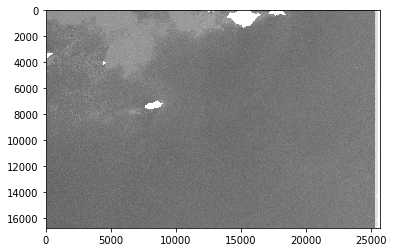

In [10]:
plt.imshow(-10*np.log10(sigma_vv), 'gray')

In [12]:
sub = sigma_vv[10000:16000, 15000:25000]

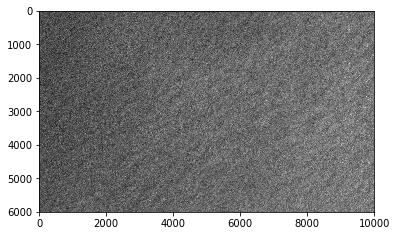

In [13]:
plt.imshow(-10*np.log10(sub), 'gray')

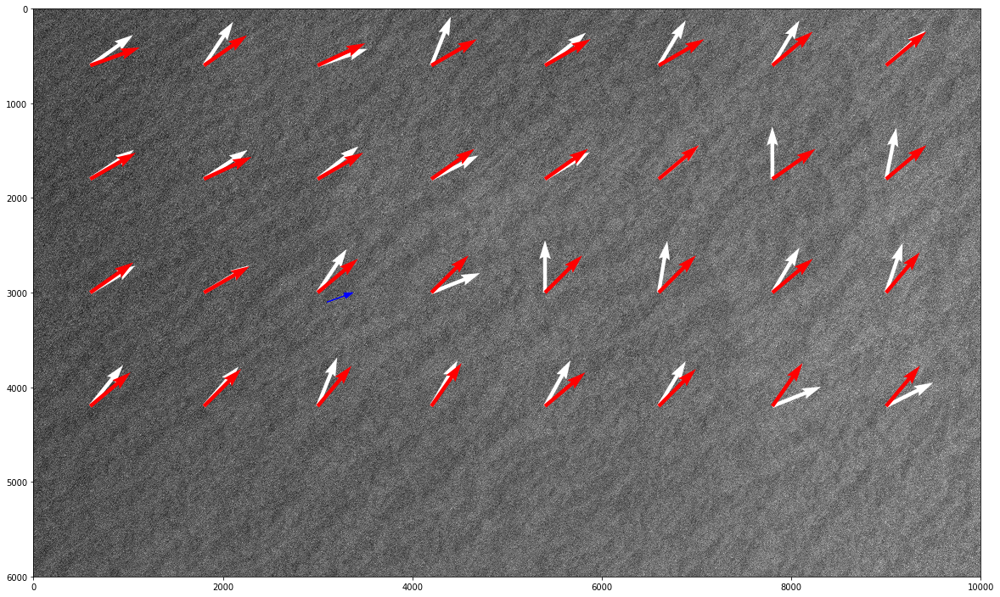

In [18]:
ndbc_dire = (190-300+90)%360
dire_ = direction.get_dir(sub, sub_size=1200, remove_ambi = True, ndbc_= ndbc_dire)
direction.plot_dir(dire_, sub, sub_size=1200, file_name='./newwind_0d7a_8.eps')
plt.arrow(3100, 3100, 200*np.cos(ndbc_dire/180*np.pi), 200*np.sin(ndbc_dire/180*np.pi), color=(0, 0, 1),width=0.04,head_width=60)

In [3]:
data = Dataset('./S1A_IW_GRDH_1SDV_20170518T233538_20170518T233603_016643_01B9E6_D58F.nc')
sigma_vv = data.variables['Sigma0_VV'][:]

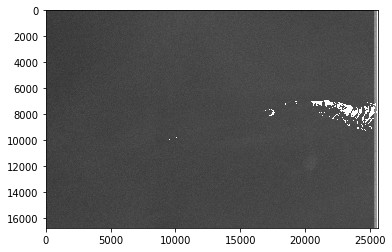

In [4]:
plt.imshow(-10*np.log10(sigma_vv), 'gray')

In [5]:
sub = sigma_vv[11500:14000,7300:10300]

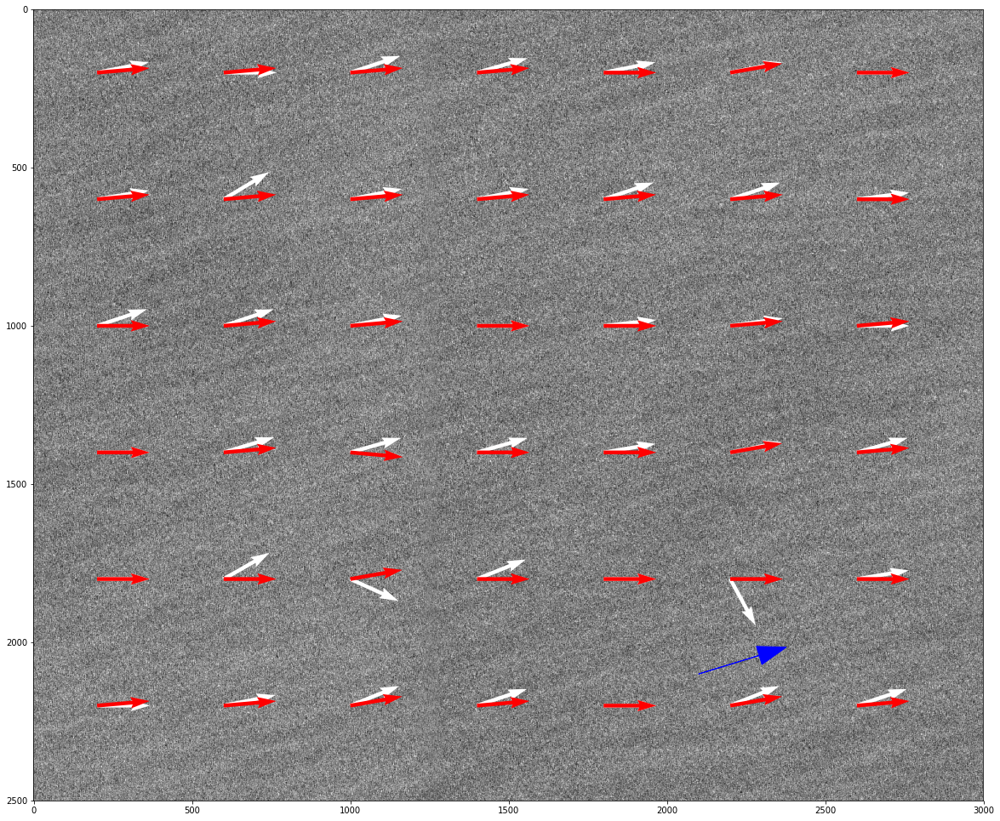

In [8]:
ndbc_dire = (350-97+90)%360
dire_ = direction.get_dir(sub, sub_size=400, remove_ambi = True, ndbc_= ndbc_dire)
direction.plot_dir(dire_, sub, sub_size=400, file_name='./wind_d58f_4.eps')
plt.arrow(2100, 2100, 200*np.cos(ndbc_dire/180*np.pi), 200*np.sin(ndbc_dire/180*np.pi), color=(0, 0, 1),width=0.04,head_width=60)

In [9]:
data = Dataset('./S1A_IW_GRDH_1SDV_20170518T141604_20170518T141629_016637_01B9B7_C40C.nc')
sigma_vv = data.variables['Sigma0_VV'][:]

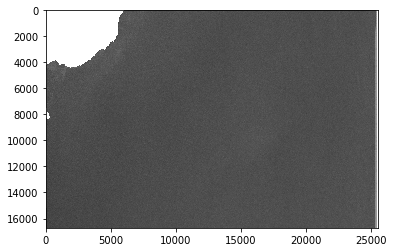

In [10]:
plt.imshow(-10*np.log10(sigma_vv), 'gray')

In [12]:
sub = sigma_vv[10200:14000,15800:20500]

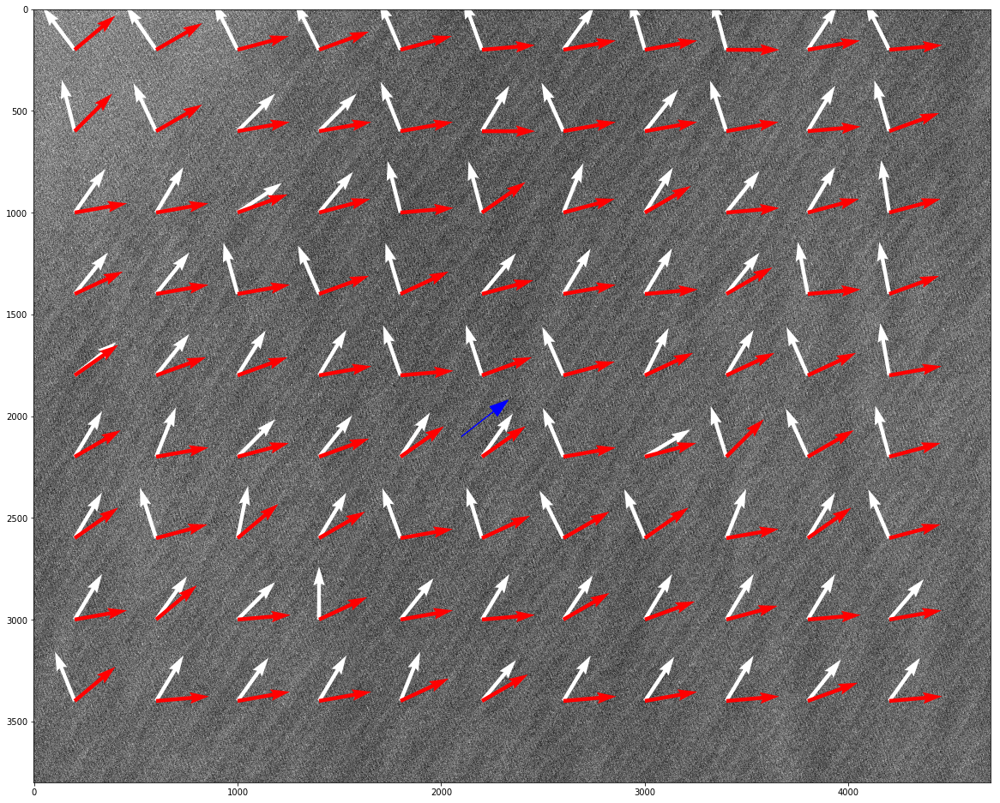

In [13]:
ndbc_dire = (190-318+90)%360
dire_ = direction.get_dir(sub, sub_size=400, remove_ambi = True, ndbc_= ndbc_dire)
direction.plot_dir(dire_, sub, sub_size=400, file_name='./wind_c40c_4.eps')
plt.arrow(2100, 2100, 200*np.cos(ndbc_dire/180*np.pi), 200*np.sin(ndbc_dire/180*np.pi), color=(0, 0, 1),width=0.04,head_width=60)

In [14]:
data = Dataset('./S1A_IW_GRDH_1SDV_20170520T001818_20170520T001843_016658_01BA5D_566B.nc')
sigma_vv = data.variables['Sigma0_VV'][:]

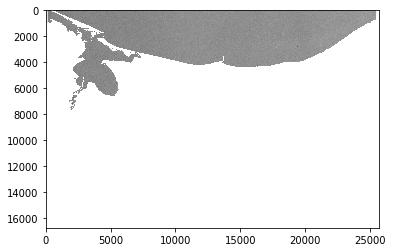

In [15]:
plt.imshow(-10*np.log10(sigma_vv), 'gray')

In [16]:
sub = sigma_vv[350:3750,15300:19100]

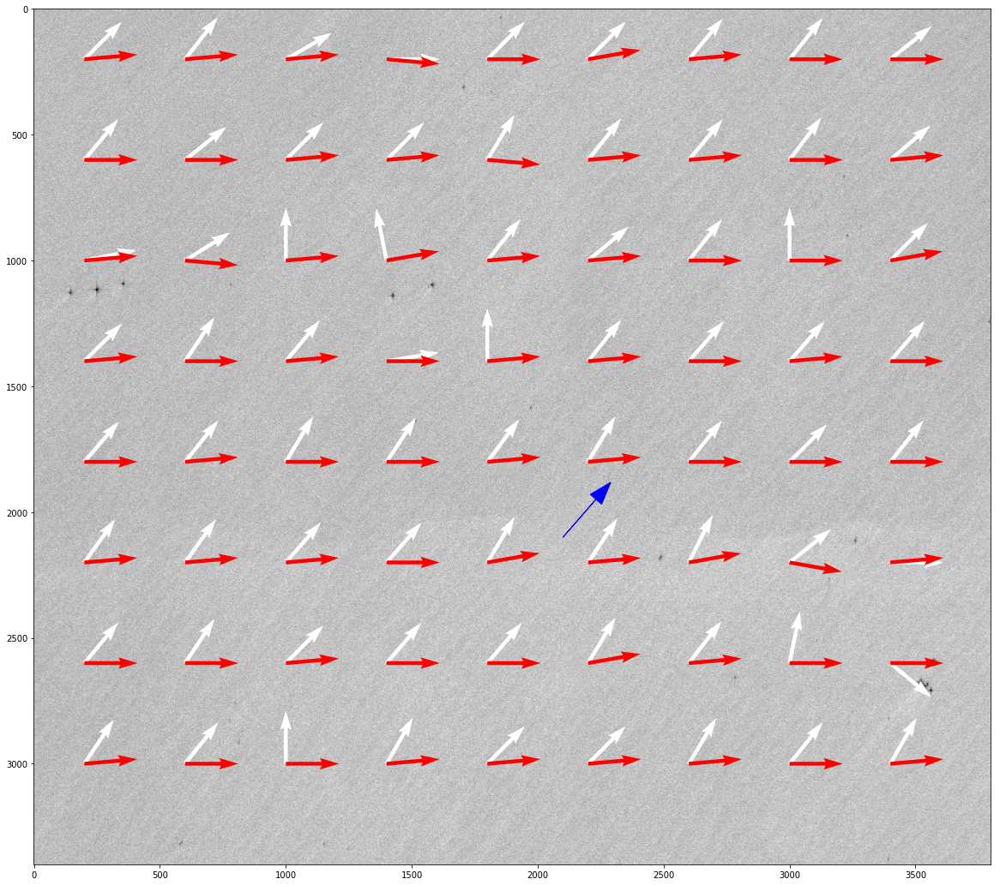

In [17]:
ndbc_dire = (350-129+90)%360
dire_ = direction.get_dir(sub, sub_size=400, remove_ambi = True, ndbc_= ndbc_dire)
direction.plot_dir(dire_, sub, sub_size=400, file_name='./wind_566b_4.eps')
plt.arrow(2100, 2100, 200*np.cos(ndbc_dire/180*np.pi), 200*np.sin(ndbc_dire/180*np.pi), color=(0, 0, 1),width=0.04,head_width=60)